Spring 2021 - Social Data Analysis and Visualization (02806) - DTU

# SF311 - Final Project

## Table of Contents

* [1. Motivation](#c1)

* [2. Basic Statistics](#c2)
    * [2.1 Data Preperation](#s_2_1)
        * [2.1.1 Data and Basic Statistics](#s_2_1_1)
        * [2.1.2 Cleaning and Filtering](#s_2_1_2)
    * [2.2 Preliminary Explorations and Conclusions](#s_2_2)
    
* [3. Data Analysis](#c3)
    * [3.1 Temporal Patterns](#s_3_1)
        * [3.1.1 Development over time](#s_3_1_1)
        * [3.1.2 Before and After Covid](#s_3_1_2)
    * [3.2 Spatiotemporal Patterns](#s_3_2)
        * [3.2.1 Investigating Yearly Patterns](#s_3_2_1)
        * [3.2.2 Investigating Monthly Patterns](#s_3_2_2)
        * [3.2.3 Investigating Daily Patterns](#s_3_2_3)
    * [3.3 Cluster Analysis](#s_3_3)
        * [3.3.1 Learning Clusters](#s_3_3_1)
        * [3.3.2 Visualizing and Exploring Clusters](#s_3_3_2)
* [4. Genre](#c4)
* [5. Visualization](#c5)
* [6. Discussion](#c6)
* [7. Contributions](#c7)
* [8. References](#c8)

## 1. Motivation  <a class="anchor" id="c1"></a>

Exploring the Open Data database of San Francisco we chose the SF311 dataset because it gives valuable insight into the public life of San Francisco residents. Further, the dataset and the vast amount of information it contains, is highly relevant to several departments within the government of San Francisco. The dataset contains service requests within different categories filed by the citizens of San Francisco. For each complaint the dataset contains a lot of information such as; geographical location, time of complaint, category, source of complaint, and much more. With this vast amount of information our main purpose is to communicate key insights from the dataset in a clear and structured manner. Additionally, our goal is for the reader to feel like he is on a guided tour of the SF311 dataset leaving the tour with valuable insight into how the complaint categories develop over time, distribute geographically across the city and whether some neighbourhoods are similar in the concentration of different complaint types.

## 2. Basic Statistics <a class="anchor" id="c2"></a>

### 2.1 Data Preperation <a class="anchor" id="s_2_1"></a>

#### 2.1.1 Data and Basic Statistics <a class="anchor" id="s_2_1_1"></a>

We start by importing the libaries and the main main dataset used in this project. It is composed by around 4.8 million observations and 47 variables, occupying a total size of 2.1 GB. Below is printed a list of all the variables the dataset provides, as well as a preview of the first rows of it.

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from scipy import stats
import chart_studio
import chart_studio.plotly as py
import plotly.offline as pyo
import plotly.graph_objects as go
import plotly.express as px
from plotly.graph_objs.scatter.marker import Line

pyo.init_notebook_mode()
chart_studio.tools.set_credentials_file(username='mmestre', api_key='YbVYpQRqmw3RvNPohYBn')

In [2]:
#Import of the main dataset
SF_311 = pd.read_csv("311_cases.csv")

In [3]:
SF311_columns = SF_311.columns

print('The dataset is composed by the following columns:\n'+ str(SF311_columns))
print('\n Its size is '+str(SF_311.shape[0])+' rows and '+str(SF_311.shape[1])+' columns in total.')
SF_311.head()

The dataset is composed by the following columns:
Index(['CaseID', 'Opened', 'Closed', 'Updated', 'Status', 'Status Notes',
       'Responsible Agency', 'Category', 'Request Type', 'Request Details',
       'Address', 'Street', 'Supervisor District', 'Neighborhood',
       'Police District', 'Latitude', 'Longitude', 'Point', 'Source',
       'Media URL', 'SF Find Neighborhoods', 'Current Police Districts',
       'Current Supervisor Districts', 'Analysis Neighborhoods',
       'DELETE - Supervisor Districts', 'DELETE - Fire Prevention Districts',
       'DELETE - Current Police Districts', 'DELETE - Zip Codes',
       'DELETE - Police Districts', 'DELETE - Neighborhoods',
       'DELETE - Neighborhoods_from_fyvs_ahh9', 'DELETE - 2017 Fix It Zones',
       'DELETE - SF Find Neighborhoods',
       'Civic Center Harm Reduction Project Boundary',
       'DELETE - Current Supervisor Districts',
       'Fix It Zones as of 2017-11-06 ', 'Invest In Neighborhoods (IIN) Areas',
       'DELETE - 

,CaseID,Opened,Closed,Updated,Status,Status Notes,Responsible Agency,Category,Request Type,Request Details,...,DELETE - HSOC Zones,Fix It Zones as of 2018-02-07,"CBD, BID and GBD Boundaries as of 2017",Central Market/Tenderloin Boundary,"Areas of Vulnerability, 2016",Central Market/Tenderloin Boundary Polygon - Updated,HSOC Zones as of 2018-06-05,OWED Public Spaces,Parks Alliance CPSI (27+TL sites),Neighborhoods
0,10622276,03/19/2019 04:44:32 PM,NaN,08/28/2020 01:31:06 AM,Open,accepted,DPW BSM Queue,Sidewalk or Curb,Sidewalk_Defect,Collapsed_sidewalk,...,NaN,NaN,NaN,NaN,1.0,NaN,NaN,NaN,NaN,54.0
1,10704816,04/09/2019 07:08:53 AM,NaN,08/28/2020 01:31:03 AM,Open,accepted,DPW BSM Queue,Sidewalk or Curb,Sidewalk_Defect,Lifted_sidewalk_tree_roots,...,NaN,NaN,NaN,NaN,2.0,NaN,NaN,NaN,NaN,100.0
2,10892486,05/21/2019 04:11:00 PM,08/28/2020 07:46:00 AM,08/28/2020 07:46:00 AM,Closed,Case Resolved - Loose PG&E vault doors and sun...,DPW BSM Queue,Sidewalk or Curb,Sidewalk_Defect,Lifted_sidewalk_other,...,NaN,NaN,NaN,NaN,1.0,NaN,NaN,NaN,NaN,29.0
3,11866528,12/27/2019 12:09:00 PM,01/08/2020 09:30:13 PM,01/08/2020 09:30:13 PM,Closed,Case Resolved - Per process - cases are closed...,Clear Channel - Transit Queue,Street and Sidewalk Cleaning,Transit_shelter_platform,Transit_shelter_platform,...,NaN,NaN,NaN,NaN,1.0,NaN,NaN,35.0,NaN,108.0
4,10650674,03/26/2019 08:26:28 PM,NaN,07/15/2020 01:25:53 AM,Open,accepted,DPW - Bureau of Street Use and Mapping - G,General Request - PUBLIC WORKS,request_for_service,bsm - request_for_service,...,NaN,NaN,4.0,NaN,2.0,NaN,NaN,NaN,NaN,32.0


The dataset **basic statistics** are briefly outlined in the following overview:

- Total columns: 47
- Total rows: 4770783
- Total number of complaint categories: 103
- Top 20 complaint categories count: 4418865
- Top 20 complaint categories % overall: 92.6%

But we can even look at the representation of the top 8 complaint categories.
- Top 10 complaint categories count: 3707477
- Top 10 complaint categories % overall: 77.7%
- The top 3 categories are grouped as following:
 - _**Street and Sidewalk Cleaning**_ with a total of 1688126 complaints representing the 35.4% of the total.
 - _**Graffiti**_ with a total of 611864 complaints representing the 12.8% of the total.
 - _**Encampments**_ with a total of 289196 complaints representing the 6.1% of the total.

The other **columns** of interest are as follows.
* The recorded complaints range from the July 2008 til April 2021. Therefore whole years in the dataset are from 2009 to 2020.


* We are provided of a total of 119 different small *Neighbourhoods*, 41 bigger *Analysis Neighbourhoods* and the wider categorization of *Police District* with at a total of 12 different districts.


* The dataset also contains two columns called _Longitude_ and _Latitude_ which contain geographic data, very useful to obtain insights about the location of the complaints.


* The different sources SF311 has to communicate with SF citizens and obtain their complaints are via:
    - Email, Integrated Agency, Mail, Mobile/Open311, Other Department, Phone, Twitter and Web.

##### Importing GeoData
We decide that the *Analysis Neighbourhood* is the best compromise between capturing details and communicating a bigger picture, so we import geojson data that contain the geometry of 41 neighbourhoods in SF. The SF311 dataset has the same neighbourhoods in the column, but they are numbered 1-41, so the first task was couple the geojson neighbourhood names with the corresponding neighbourhoods in SF311 dataset. This was done by plotting the longitudes and latitudes from both dataset and then manually write down which corresponded to each other.

In [4]:
import geojson

# import neighborhood geojson data
with open('sf_nhood.geojson') as f:
    gj = geojson.load(f)

#Extract the names of neighborhoods
nhoods = []
for i in range(41):
    name = gj['features'][i]['properties']['nhood']
    nhoods.append(name)
    
## map neighborhood name in geojson into correspond neighborhood in SF311
name_map=[[1,1],[2,2],[3,5],[4,6],[5,7],[6,8],[7,10],[8,11],[9,12],[10,3],[11,9],[12,14],[13,15],[14,19],[15,36],
          [16,16],[17,17],[18,18],[19,13],[20,32],[21,20],[22,4],[23,21],[24,33],[25,22],[26,23],[27,24],[28,34],[29,35],[30,28],
          [31,29],[32,30],[33,25],[34,26],[35,27],[36,31],[37,37],[38,38],[39,40],[40,41],[41,39]]

#index_gj holds the names for the SF311 neighborhood 
index_gj = ['']*41
for i in range(41):
    name = nhoods[name_map[i][0]-1]
    index = name_map[i][1]-1
    index_gj[index] = name

#### 2.1.2 Cleaning and Filtering <a class="anchor" id="s_2_1_2"></a>
We are going to narrow down and prepocess the data, before the data analysis can begin.

In [5]:
# Copy data 
df = SF_311.copy()

##### Making relevant datetime columns
First we make datetime columns, so we can easily access the recorded times. We will not analyse request processing time, so we will only use the ‘Opened Time’, refering to when the request was registered by 311. 

In [6]:
# converting to datetime and creating some useful columns for easy filtering
df['Opened_DT'] = pd.to_datetime(df['Opened'], format = '%m/%d/%Y %I:%M:%S %p')
df['Closed_DT'] = pd.to_datetime(df['Closed'], format = '%m/%d/%Y %I:%M:%S %p')
df['Updated_DT'] = pd.to_datetime(df['Updated'], format = '%m/%d/%Y %I:%M:%S %p')

df['Opened_Year'] = df.Opened_DT.dt.year
df['Opened_Month'] = df.Opened_DT.dt.month
df['Opened_Hour'] = df.Opened_DT.dt.hour
df['Opened_Year_Month'] = df.Opened_DT.dt.strftime('%Y-%m')
#df['Opened_Hour_Minute'] = df.Opened_DT.dt.strftime('%I:%M')
df['Opened_Hour_Minute'] = df.Opened_Hour + df.Opened_DT.dt.minute/60
df['DOW_num'] = df.Opened_DT.dt.weekday
df['DOW'] = df.Opened_DT.dt.strftime('%A')
df['DOW_Hour'] = df.Opened_DT.dt.strftime('%A-%I')
df['Month_Str'] = df.Opened_DT.dt.strftime('%b')
df.sort_values(by=['DOW_num'],inplace=True) #order the dataframe sorting it by day of the week

dow = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']
sorted_months = ['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun', 'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec']

##### Deleting half years
We exclude the years 2008 and 2021 since these are incomplete years.

In [7]:
df_all_years = df.copy()
df = df[(df.Opened_Year.between(2009,2020))]

#####   Filtering and merging the categories

As we explained e can choose to focus on the 20 most requested ones, which we have calculated to represent **92.6%** of all the requests, or the top 10 complaints, which represent the **77.7%** of all the requests.

We are also interested in the greater themes of complaints, so we went through the categories and merged selected ones, for example the four different categories that relates to the MUNI feedback, into one.

In [8]:
focusrequests_20 = ['Street and Sidewalk Cleaning', 'Graffiti', 'Encampments', 
                 'Abandoned Vehicle', 'MUNI Feedback', 'Parking Enforcement', 
                'General Request - PUBLIC WORKS', 'Damaged Property', 'Sewer Issues', 'Tree Maintenance', 
                 'General Request - MTA', 'Illegal Postings', 'Streetlights', 'Street Defects', 'Litter Receptacles', 
                 'Rec and Park Requests', 'SFHA Requests', 'Sign Repair', 'Sidewalk or Curb', 'Noise Report']

focusrequests_10 = ['Street and Sidewalk Cleaning', 'Graffiti', 'Encampments', 
                 'Abandoned Vehicle', 'MUNI Feedback', 'Parking Enforcement', 
                'General Request - PUBLIC WORKS', 'Damaged Property', 'Sewer Issues', 'Tree Maintenance']

focusrequests_22 = ['Street and Sidewalk Cleaning', 'Graffiti', 'Encampments', 'Abandoned Vehicle', 
                 'MUNI Feedback', 'Parking Enforcement', 'General Request - PUBLIC WORKS', 'Damaged Property', 
                 'Sewer Issues', 'Tree Maintenance', 'General Request - MTA', 'Illegal Postings', 'Streetlights', 
                 'Street Defects', 'Litter Receptacles', 'Rec and Park Requests', 'SFHA Requests','Sign Repair',
                 'Sidewalk or Curb','Noise Report','Blocked Street or SideWalk','Homeless Concerns']

In [9]:
### Merge selected 
merg2 = ['MUNI Feedback','Muni Service Feedback', 'Muni Employee Feedback', 'General Request - MUNI']
df.Category = df.Category.replace(merg2[1],merg2[0])
df.Category = df.Category.replace(merg2[2],merg2[0])
df.Category = df.Category.replace(merg2[3],merg2[0])

merg3 = ['Homeless Concerns', 'General Request - HSH']
df.Category = df.Category.replace(merg3[1],merg3[0])

### 2.2 Preliminary Explorations and Conclusions <a class="anchor" id="s_2_2"></a> 

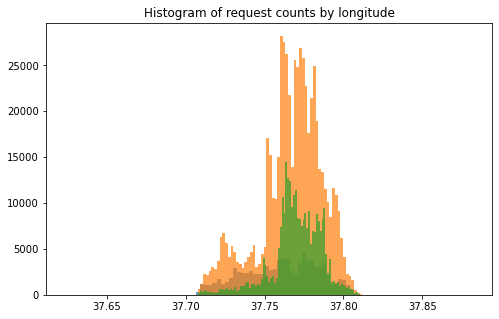

In [10]:
# pick categories
d_sub1 = df.loc[df.Category.isin(["Tree Maintenance"])]["Latitude"]
d_sub2 = df.loc[df.Category.isin(["Graffiti"])]["Latitude"]
d_sub3 = df.loc[df.Category.isin(["Encampments"])]["Latitude"]

d_sub1 = d_sub1[d_sub1 > 35]
d_sub2 = d_sub2[d_sub2 > 35]
d_sub3 = d_sub3[d_sub3 > 35]

# plot categories in one histogram
plt.figure(figsize = (8,5))
plt.hist(d_sub1, bins = 100, alpha = 0.7)
plt.hist(d_sub2, bins = 100, alpha = 0.7)
plt.hist(d_sub3, bins = 100, alpha = 0.7)
plt.title('Histogram of request counts by longitude')
plt.show()

The histogram above illustrates one of the first findings of our exploratory data analysis. By exploring the geographical distribution of several service request categories, using histograms plotting request count over longitude and latitude, we initially found that the requests for each category are distributed differently across the city of San Francisco. This initial finding lead us to want to investigate how the geographical distribution of complaints changes over time, ie. years, months and hours of the day.

Secondly, by plotting the distribution of complaints in geographical scatterplots, we found that some areas have higher concentrations of certain request categories. Further, we implemented a choropleth map with police districts, where we found that some districts have higher concentrations of certain request types as well. These findings led us to implement a choropleth map with neighbourhoods as well, allowing us to investigate whether some neighbourhoods have higher concentrations of certain request types as well. Additionally, these findings sparked an investigation into whether neighbourhoods can be clustered into meaningful clusters of similar neighbourhoods.

To control the size of this notebook, these Folium plots were not included. However, the final implementation of the choropleth plot and clustering algorithm can be found in part [3.3.2](#s_3_3_2)

## 3. Data Analysis <a class="anchor" id="c3"></a>

### 3.1 Temporal Patterns <a class="anchor" id="s_3_1"></a>

The first visualization focuses on the total count of complaints by the different categories these fall into. In the whole dataset there is a total number of 103 different categories, although the majority of them are very poorly represented. In fact, the top 20 categories (around a 20% of all the different categories found in the dataset) represent the 92.6% of all the complaints. In the plot below there is a visual representation of these top 20 categories, what is their total count value, and they can be easily compared between them.

In [11]:
focusrequests = focusrequests_20
df3 = df[df.Category.isin(focusrequests)]

df_complain_count = df3.groupby(['Category'], as_index=False).count()

df_complain_count.sort_values(by=['CaseID'],inplace=True,ascending=False)
fig = go.Figure([go.Bar(x=df_complain_count['Category'], y=df_complain_count['CaseID'])])

# Set titles
fig.update_layout(
    title="Count of complaints 2009-2021",
    xaxis_title="Complaint category",
    yaxis_title="Count of complaints",
    autosize=False,
    width=980,
    height=500,
)
fig.show()
#py.plot(fig, filename='complain-count-2009-2021')

#### 3.1.1 Development over time<a class="anchor" id="s_3_1_1"></a>

Narrowing it down even more to the top 10 categories, they account for 77.7% of the total complaints of the whole dataset. The plot below has been designed focusing on the user experience and in order to offer the maximum level of interaction. Two main modes are introduced offering a more in depth insight of each complaint category evolution over time. In addition, a time window widget has been added right below the plot, so it makes it easier to navigate through the data, independently if it is years or months you want to look into.

In [12]:
focusrequests = focusrequests_10
df3 = df[df.Category.isin(focusrequests)]
df_c = df3

df_c_year = df_c.groupby(['Opened_Year','Category'], as_index=False).count()
df_c_year_month = df_c.groupby(['Opened_Year_Month','Category'], as_index=False).count()

fig = go.Figure() #Initialization of the figure (Plotly - Graph Objects)

complaints_list = list()

for complaint_type in df_c['Category'].unique():
    complaints_list.append(str(complaint_type))
    fig.add_trace(
        go.Bar(x = df_c_year[df_c_year['Category']==complaint_type]['Opened_Year'],
               y = df_c_year[df_c_year['Category']==complaint_type]['CaseID'],
               name = complaint_type))
    fig.add_trace(
        go.Bar(x = df_c_year_month[df_c_year_month['Category']==complaint_type]['Opened_Year_Month'],
               y = df_c_year_month[df_c_year_month['Category']==complaint_type]['CaseID'],
               visible=False,
               name = complaint_type))

button_layer_1_height = 1.12 # Add drowdowns
fig.update_layout(
    updatemenus=[
        dict(           
            buttons=list([
                dict(label="All by Year",
                     method="update",
                     args=[{"visible": [True, False, True, False, True, False,
                                        True, False, True, False, True, False,
                                        True, False, True, False, True, False
                                       ]},
                           {"title": "Complaint type"}]),
                dict(label="All by Year-Month",
                     method="update",
                     args=[{"visible": [False, True, False, True, False, True,
                                        False, True, False, True, False, True,
                                        False, True, False, True, False, True
                                       ]},
                           {"title": "Complaint type"}]),
            ]),            
            type="buttons",
            direction="right",
            active=0,
            x=1.0,
            y=1.2,
        ),
        dict(
            buttons=list([
                dict(label="All by Year",
                     method="update",
                     args=[{"visible": [True, False, True, False, True, False,
                                        True, False, True, False, True, False,
                                        True, False, True, False, True, False,
                                        True, False, True, False, True, False,
                                        True, False, True, False, True, False,
                                       ]},
                           {"title": "Complaint type:"}]),
                dict(label=str(complaints_list[0]),
                     method="update",
                     args=[{"visible": [True] + 19*[False]},
                           {"title": "Complaint type:<br>" + str(complaints_list[0]) + " by Year"}]),
                dict(label=str(complaints_list[1]),
                     method="update",
                     args=[{"visible": 2*[False] + [True] + 17*[False]},
                           {"title": "Complaint type:<br>" + str(complaints_list[1]) + " by Year"}]),
                dict(label=str(complaints_list[2]),
                     method="update",
                     args=[{"visible": 4*[False] + [True] + 15*[False]},
                           {"title": "Complaint type:<br>" + str(complaints_list[2]) + " by Year"}]),
                dict(label=str(complaints_list[3]),
                     method="update",
                     args=[{"visible": 6*[False] + [True] + 13*[False]},
                           {"title": "Complaint type:<br>" + str(complaints_list[3]) + " by Year"}]),
                dict(label=str(complaints_list[4]),
                     method="update",
                     args=[{"visible": 8*[False] + [True] + 11*[False]},
                           {"title": "Complaint type:<br>" + str(complaints_list[4]) + " by Year"}]),
                dict(label=str(complaints_list[5]),
                     method="update",
                     args=[{"visible": 10*[False] + [True] + 9*[False]},
                           {"title": "Complaint type:<br>" + str(complaints_list[5]) + " by Year"}]),
                dict(label=str(complaints_list[6]),
                     method="update",
                     args=[{"visible": 12*[False] + [True] + 7*[False]},
                           {"title": "Complaint type:<br>" + str(complaints_list[6]) + " by Year"}]),
                dict(label=str(complaints_list[7]),
                     method="update",
                     args=[{"visible": 14*[False] + [True] + 5*[False]},
                           {"title": "Complaint type:<br>" + str(complaints_list[7]) + " by Year"}]),
                dict(label=str(complaints_list[8]),
                     method="update",
                     args=[{"visible": 16*[False] + [True] + 3*[False]},
                           {"title": "Complaint type:<br>" + str(complaints_list[8]) + " by Year"}]),
                dict(label=str(complaints_list[9]),
                     method="update",
                     args=[{"visible": 18*[False] + [True] + [False]},
                           {"title": "Complaint type:<br>" + str(complaints_list[9]) + " by Year"}]),
            ]),
            direction="down",
            pad={"r": 10, "t": 10},
            showactive=True,
            x=0.43,
            xanchor="left",
            y=button_layer_1_height,
            yanchor="top"
        ),
        dict(
            buttons=list([
                dict(label="All by Year-Month",
                     method="update",
                     args=[{"visible": [False, True, False, True, False, True,
                                        False, True, False, True, False, True,
                                        False, True, False, True, False, True,
                                        False, True, False, True, False, True,
                                        False, True, False, True, False, True
                                       ]},
                           {"title": "Complaint type:"}]),
                dict(label=str(complaints_list[0]),
                     method="update",
                     args=[{"visible": [False] + [True] + 18*[False]},
                           {"title": "Complaint type:<br>" + str(complaints_list[0]) + " by Year-month"}]),
                dict(label=str(complaints_list[1]),
                     method="update",
                     args=[{"visible": 3*[False] + [True] + 16*[False]},
                           {"title": "Complaint type:<br>" + str(complaints_list[1]) + " by Year-month"}]),
                dict(label=str(complaints_list[2]),
                     method="update",
                     args=[{"visible": 5*[False] + [True] + 14*[False]},
                           {"title": "Complaint type:<br>" + str(complaints_list[2]) + " by Year-month"}]),
                dict(label=str(complaints_list[3]),
                     method="update",
                     args=[{"visible": 7*[False] + [True] + 12*[False]},
                           {"title": "Complaint type:<br>" + str(complaints_list[3]) + " by Year-month"}]),
                dict(label=str(complaints_list[4]),
                     method="update",
                     args=[{"visible": 9*[False] + [True] + 10*[False]},
                           {"title": "Complaint type:<br>" + str(complaints_list[4]) + " by Year-month"}]),
                dict(label=str(complaints_list[5]),
                     method="update",
                     args=[{"visible": 11*[False] + [True] + 8*[False]},
                           {"title": "Complaint type:<br>" + str(complaints_list[5]) + " by Year-month"}]),
                dict(label=str(complaints_list[6]),
                     method="update",
                     args=[{"visible": 13*[False] + [True] + 6*[False]},
                           {"title": "Complaint type:<br>" + str(complaints_list[6]) + " by Year-month"}]),
                dict(label=str(complaints_list[7]),
                     method="update",
                     args=[{"visible": 15*[False] + [True] + 4*[False]},
                           {"title": "Complaint type:<br>" + str(complaints_list[7]) + " by Year-month"}]),
                dict(label=str(complaints_list[8]),
                     method="update",
                     args=[{"visible": 17*[False] + [True] + 2*[False]},
                           {"title": "Complaint type:<br>" + str(complaints_list[8]) + " by Year-month"}]),
                dict(label=str(complaints_list[9]),
                     method="update",
                     args=[{"visible": 19*[False] + [True]},
                           {"title": "Complaint type:<br>" + str(complaints_list[9]) + " by Year-month"}]),          
            ]),
            direction="down",
            pad={"r": 10, "t": 10},
            showactive=True,
            x=0.72,
            xanchor="left",
            y=button_layer_1_height,
            yanchor="top"
        ),
    ]
)
    
fig.update_layout(
    xaxis=dict(
        rangeselector=dict(
            buttons=list([
                dict(count=3,
                     label="Last 3 years",
                     step="year",
                     stepmode="backward"),
                dict(count=5,
                     label="Last 5 Years",
                     step="year",
                     stepmode="backward"),
                dict(count=10,
                     label="Last 10 years",
                     step="year",
                     stepmode="backward"),
                dict(step="all", label="All")
            ]),
            x=0.37,
            y=1.13
        ),
        rangeslider=dict(
            visible=True
        ),
        type="date"
    )
)

    
# Set titles
fig.update_layout(
    title="Complaint count over time",
    xaxis_title="Date",
    yaxis_title="Count of complaints",
    autosize=False,
    width=1000,
    height=700,
)

fig.update_layout(legend=dict(x=0, y=1, bgcolor='rgba(255, 255, 255, 0)'))
fig.update_yaxes(automargin=True)
fig.show()
#py.plot(fig, filename='complain-count-dropdown')

The aim of the following sets of plots is to analyze and visualize the complaint development over time in San Francisco. By looking at the dataset from these particular perspectives we intend to identify and detect complaint trends taking into consideration months, days of the week, or hours of the day.

##### Complaint count by week day
The bar charts below show the number of complaints in the city grouped by each day of the week.

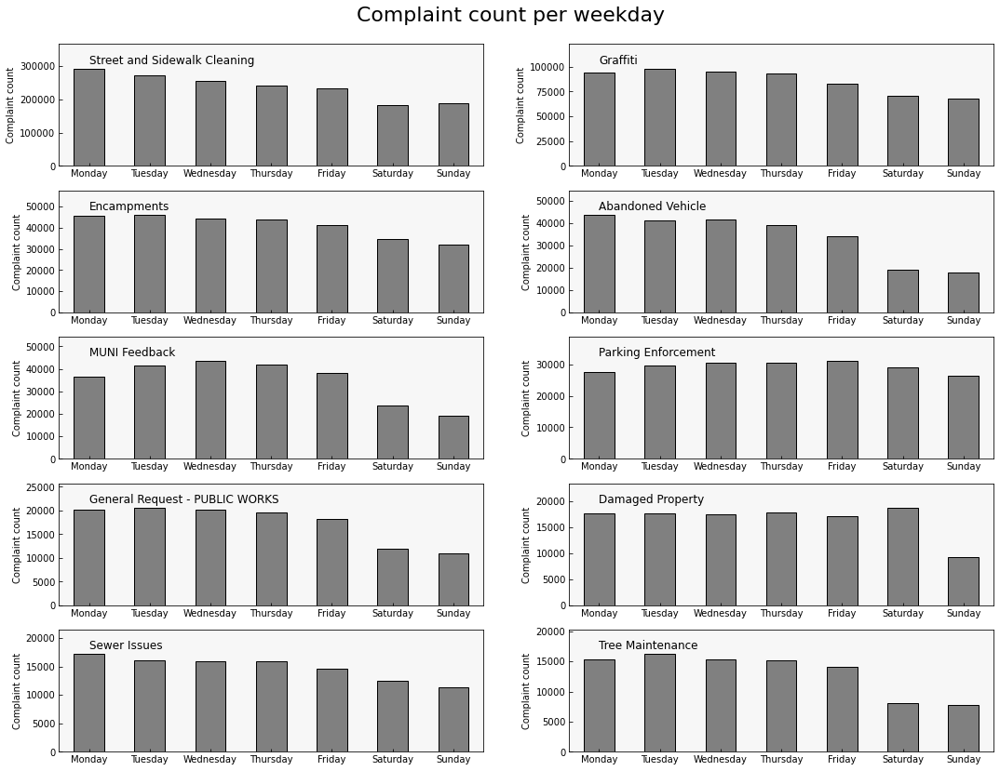

In [13]:
# we first set out the shape and number of graphs we require
fig, axs = plt.subplots(nrows = 5, ncols = 2, figsize = (18,14))
fig.patch.set_facecolor('#FFFFFF')
fig.suptitle('Complaint count per weekday', fontsize=22,x=0.5, y=0.92)

for i, cat in enumerate(focusrequests_10):    # in this loop we accordingly detail each one of the plots
    ax = axs[i//2,i%2]
    df_ct = df[df.Category == cat]
    df_ct_dow = df_ct.groupby('DOW').DOW.count() 
    df_ct_dow_sorted = df_ct_dow[dow]
    df_ct_dow_sorted.plot(kind = 'bar', ax = ax, rot=0, align='center', width=0.5, color='grey', 
                          edgecolor='black', ylim=(0,max(df_ct_dow_sorted)*1.25), ylabel='Complaint count')
    ax.text(x=0,y=max(df_ct_dow_sorted)*1.05,s = cat, fontsize=12)
    ax.set_xlabel(xlabel=None)
    ax.set_facecolor('#F7F7F7')
    ax.tick_params(direction='in')
#fig.savefig('weekly-complaint-count.png',dpi=200)

In the plots above several interesting trends can be observed. In general all of the 10 categories analyzed show a decrease when the weekend comes, being sunday for all of them the day with fewer complaints registered. This pattern however cannot be observed for Parking Enforcement, which has a rather constant level of complaints throughout the week. It is interesting to see how Damaged Property suffers a significant drop on Sunday, probably due to the fact that Sunday is the day of the week where most people are resting at home.


##### Complaint count by month
We now turn our attention to the number of complaints in the city grouped by months.

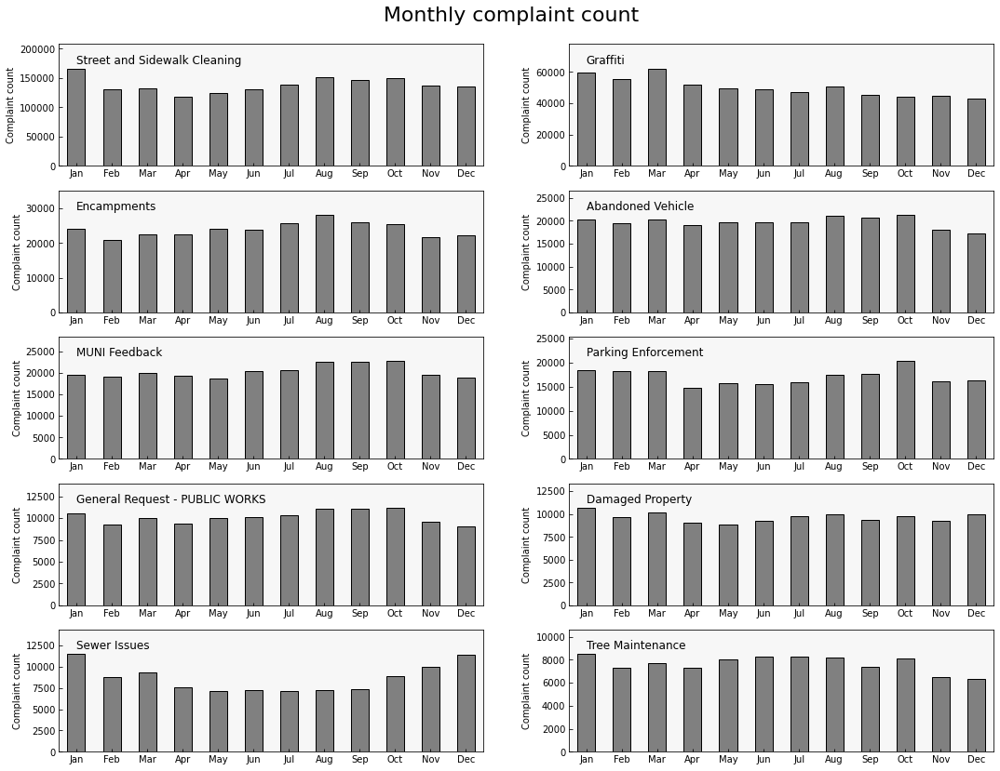

In [14]:
# we first set out the shape and number of graphs we require
fig, axs = plt.subplots(nrows = 5, ncols = 2, figsize = (18,14))
fig.patch.set_facecolor('#FFFFFF')
fig.suptitle('Monthly complaint count', fontsize=22,x=0.5,y=0.92)

for i, cat in enumerate(focusrequests_10):    # in this loop we accordingly detail each one of the plots
    ax = axs[i//2,i%2]
    df_ct = df[df.Category == cat]
    df_ct_mth = df_ct.groupby('Month_Str').Month_Str.count() 
    df_ct_mth_sorted = df_ct_mth[sorted_months]
    df_ct_mth_sorted.plot(kind = 'bar', ax = ax, rot=0, align='center', width=0.5, color='grey', 
                          edgecolor='black', ylim=(0,max(df_ct_mth_sorted)*1.25), ylabel='Complaint count')
    ax.text(x=0,y=max(df_ct_mth_sorted)*1.05,s = cat, fontsize=12)
    ax.set_xlabel(xlabel=None)
    ax.set_facecolor('#F7F7F7')
    ax.tick_params(axis='both', direction='in')
#fig.savefig('monthly-complaint-count.png',dpi=200)

It can be observed that Encampments are slightly more frequent between July and October, which makes sense because these are summer holidays months and with a nice weather. Looking at Street and Sidewalk Cleaning there is a pronounced peak in January, most likely due to new years celebrations and major events. Moving to the Sewer Issues category, it can be observed that there is a growth in complaints in the winter months, peaking in December and January.

##### Complaint count by 24h cycle
Below we break down the complaint information into the 24 hours of the day.

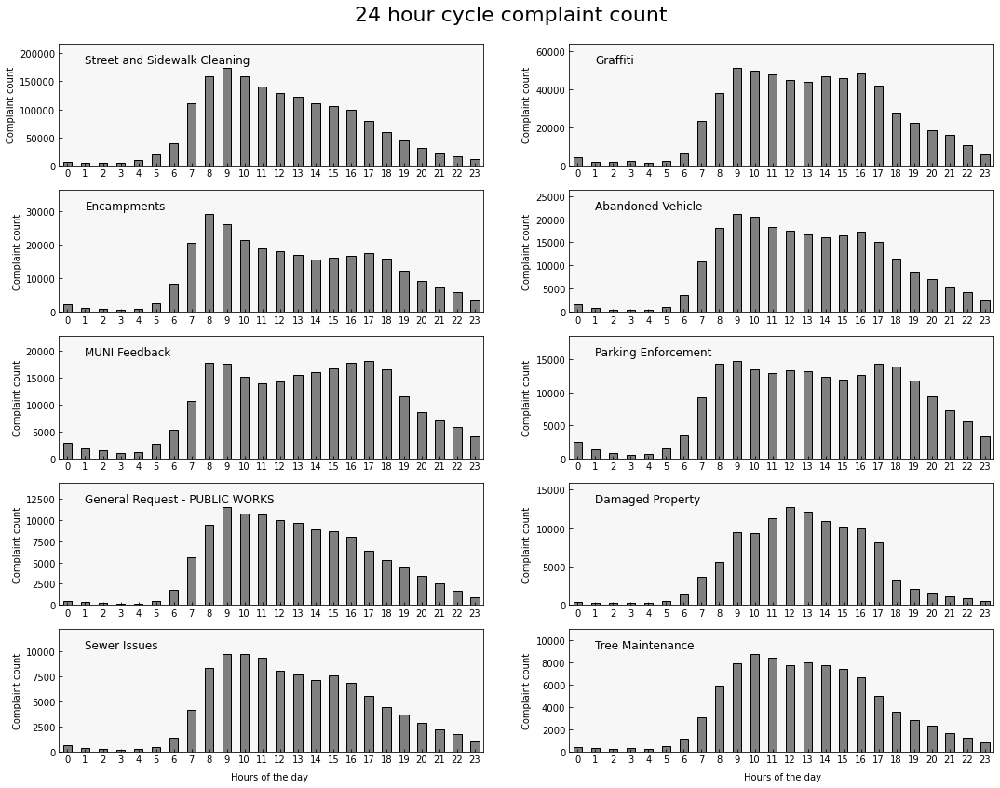

In [15]:
# we first set out the shape and number of graphs we require
fig, axs = plt.subplots(nrows = 5, ncols = 2, figsize = (18,14))
fig.patch.set_facecolor('#FFFFFF')
fig.suptitle('24 hour cycle complaint count', fontsize=22,x=0.5,y=0.92)
fig.text(0.3, 0.095, 'Hours of the day', ha='center')
fig.text(0.725, 0.095, 'Hours of the day', ha='center')

for i, cat in enumerate(focusrequests_10):    # in this loop we accordingly detail each one of the plots
    ax = axs[i//2,i%2]
    df_ct = df[df.Category == cat]
    df_ct_h = df_ct.groupby('Opened_Hour').Opened_Hour.count()
    df_ct_h.plot(kind = 'bar', ax = ax, rot=0, align='center', width=0.5, color='grey', 
                          edgecolor='black', ylim=(0,max(df_ct_h)*1.25), ylabel='Complaint count')
    ax.text(x=1,y=max(df_ct_h)*1.05,s = cat, fontsize=12)
    ax.set_xlabel(None)
    ax.set_facecolor('#F7F7F7')
    ax.tick_params(axis='both', direction='in')
#fig.savefig('complaint-count-by-24h-cycle.png',dpi=200)

At first glance it is clear to see that the number of complaints fluctuates throughout the 24-hour cycle for all categories. There is a consistent pattern across all the categories shown, and that is that between 12am and 5am the number of complaints recorded is minimal. Most of the categories peak in the morning between 8am and 10am. Some of them also show double peaks in the morning and in the afternoon, which matches with the working hours, and it is dependant on the nature of the complaint itself. For instance Parking Enforcement makes sense to show this pattern as the hours where it peaks is when people moves more, to and from home to work.

##### Complaint count by hour of the week
Finally, we aggregate the 168 hours of the week and plot them together to obtain some interesting plots

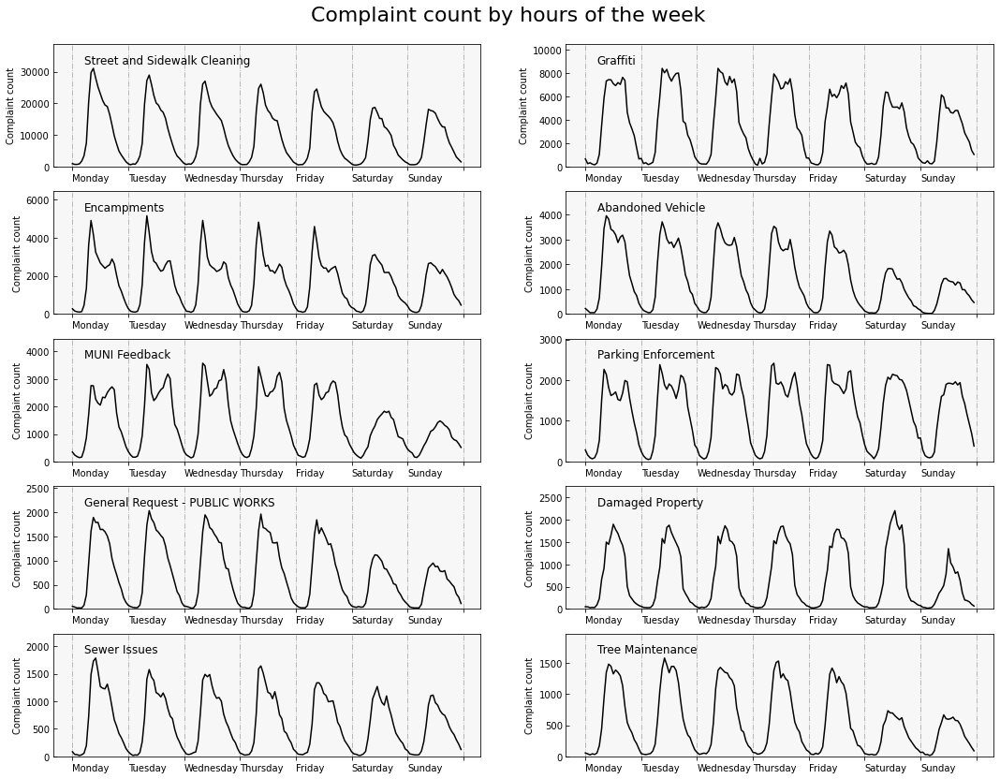

In [16]:
### we first set out the shape and number of graphs we require
fig, axs = plt.subplots(nrows = 5, ncols = 2, figsize = (18,14))
fig.patch.set_facecolor('#FFFFFF')
fig.suptitle('Complaint count by hours of the week', fontsize=22,x=0.5,y=0.92)
dow = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']
dow2 = dow.copy()
dow2.append('')

for i, cat in enumerate(focusrequests_10):    # in this loop we accordingly detail each one of the plots
    ax = axs[i//2,i%2]
    df_ct = df[df.Category == cat]
    df_ct_how = df_ct.groupby(['DOW','Opened_Hour']).Opened_Hour.count() 
    df_ct_how_sorted = df_ct_how[dow]
    df_ct_how_sorted.plot(kind = 'line', ax = ax, rot=0, color='black', ylim=(0,max(df_ct_how_sorted)*1.25),
                          ylabel='Complaint count')
    ax.text(x=5,y=max(df_ct_how_sorted)*1.05,s = cat, fontsize=12)
    ax.tick_params(axis='y', direction='in')
    ax.set_xlabel(None)
    ax.grid(linestyle='-.', linewidth='0.9', axis='x')
    ax.set_xticks(range(0,169,24))
    ax.set_facecolor('#F7F7F7')
    ax.set_xticklabels(dow2, ha='left')
    
#fig.savefig('complaint-count-by-hours-of-theweek.png',dpi=200)

When plotting the count of complaints on an hourly basis during the entire week several patterns emerge. For instance, Encampments show a pronounced spyke all mornings during the week, hoewever this pattern is not consistent when the weekend comes. What the cause of this trend might be is unclear. It is interesting to see how Saturday and Sunday do not usually show any spykes in the morning or afternoon as they do in most cases during workdays. This is probably because people in the weekends do not have a schedule as tight as during workdays and the complaints spread more evenly during the day.

In [17]:
SEED = 123
n_samples = 2000
#.sample(n_samples,random_state = SEED)
fig = go.Figure()
df5 = df[(df.Opened_Year.between(2015,2020))]
focusrequests_10 = ['Street and Sidewalk Cleaning', 'Graffiti', 'Encampments', 'Tree Maintenance','Abandoned Vehicle','Damaged Property']


for req in focusrequests_10:
    fig.add_trace(go.Violin(x=df5['Category'][df5['Category'] == req].sample(n_samples,random_state = SEED),
                            y=df5['Opened_Hour_Minute'][df5['Category'] == req].sample(n_samples,random_state = SEED),
                            name=req,
                            box_visible=True,
                            meanline_visible=True))

fig.update_layout(
                yaxis = dict(
                    tickmode = 'array',
                    tickvals = [0,2,4,6,8,10,12,14,16,18,20,22,24]),
                title="Evolution of complaints throughout the hours of the day",
                xaxis_title="Complaint category",
                yaxis_title="Hours of the day",
                autosize=False,
                width=1000,
                height=500
                ) 

    
fig.show()
#py.plot(fig, filename='violin-plot-categories')

Additionally, we have plotted five interesting categories as violin and box plots below, following the 24 hours of the day. By doing this we have a different perspective of the plots, and it is even more comfortable to just visually compare between one another. The user can select just the categories they want to compare and the shape and gridline offers a nice comfy visual appearance to take out new conclusions. For instance, one can quickly see that Street and Sidewalk Cleaning complaints are more usual in the morning, and then it decreases as the day goes by, and for the category Encampments it can be seen the more pronounced peak in the morning and then a second one late in the evening.

#### Complaints by source

The focus is now on the different channels the users use to communicate their complaints to SF311. In the plot below can be seen the 7 different sources categorized in the dataset. At first glance we see there are two categories with just a few complaints recorded. These are Email and Other Department, which in fact only have 26 and 350 appearances in the whole dataset, and therefore negligible. Phone and Mobile Open311 App stand out as the two main channels the users prefer when they want to communicate a complaint to the SF311 service.


In [18]:
df_source = df3.groupby(['Source'], as_index=False).count()
df_source.sort_values(by=['CaseID'],inplace=True,ascending=False)
fig = go.Figure([go.Bar(x=df_source['Source'], y=df_source['CaseID'])])

# Set titles
fig.update_layout(
    title="Count of complaints by source 2009-2021",
    xaxis_title="Source",
    yaxis_title="Count of complaints",
    autosize=False,
    width=1000,
    height=500,
)
fig.show()
#py.plot(fig, filename='complain-count-by-source-2009-2021')

Similarly to the plot in the previous section, the plot below is designed in order to provide the user with the highest degree of interactivity possible with the total count of complaints by sources over time, on a yearly and monthly basis. The user is invited to explore and play with this tool, finding patterns and insights.

In [19]:
focusrequests = focusrequests_10
df_c = df[df.Category.isin(focusrequests)]

df_c_year = df_c.groupby(['Opened_Year','Source'], as_index=False).count()
df_c_year_month = df_c.groupby(['Opened_Year_Month','Source'], as_index=False).count()

fig = go.Figure() #Initialization of the figure (Plotly - Graph Objects)

source_list = ['Twitter','Integrated Agency','Web','Phone','Mobile/Open311']
source_list_2 = list()

for source_type in source_list:
    source_list_2.append(str(source_type))
    fig.add_trace(
        go.Bar(x = df_c_year[df_c_year['Source']==source_type]['Opened_Year'],
               y = df_c_year[df_c_year['Source']==source_type]['CaseID'],
               name = source_type))
    fig.add_trace(
        go.Bar(x = df_c_year_month[df_c_year_month['Source']==source_type]['Opened_Year_Month'],
               y = df_c_year_month[df_c_year_month['Source']==source_type]['CaseID'],
               visible=False,
               name = source_type))
    
button_layer_1_height = 1.12  # Add drowdowns
fig.update_layout(
    updatemenus=[
        dict(           
            buttons=list([
                dict(label="All by Year",
                     method="update",
                     args=[{"visible": [True, False, True, False, True, False,
                                        True, False, True, False, True, False,
                                        True, False, True, False, True, False
                                       ]},
                           {"title": "Source type"}]),
                dict(label="All by Year-Month",
                     method="update",
                     args=[{"visible": [False, True, False, True, False, True,
                                        False, True, False, True, False, True,
                                        False, True, False, True, False, True
                                       ]},
                           {"title": "Source type"}]),
            ]),            
            type="buttons",
            direction="right",
            active=0,
            x=1.0,
            y=1.2,
        ),
        dict(
            buttons=list([
                dict(label="All by Year",
                     method="update",
                     args=[{"visible": [True, False, True, False, True, False,
                                        True, False, True, False, True, False,
                                        True, False, True, False, True, False
                                       ]},
                           {"title": "Source type:"}]),
                dict(label=str(source_list_2[0]),
                     method="update",
                     args=[{"visible": [True] + 11*[False]},
                           {"title": "Source type:<br>" + str(source_list_2[0]) + " by Year"}]),
                dict(label=str(source_list_2[1]),
                     method="update",
                     args=[{"visible": 2*[False] + [True] + 9*[False]},
                           {"title": "Source type:<br>" + str(source_list_2[1]) + " by Year"}]),
                dict(label=str(source_list_2[2]),
                     method="update",
                     args=[{"visible": 4*[False] + [True] + 7*[False]},
                           {"title": "Source type:<br>" + str(source_list_2[2]) + " by Year"}]),
                dict(label=str(source_list_2[3]),
                     method="update",
                     args=[{"visible": 6*[False] + [True] + 5*[False]},
                           {"title": "Source type:<br>" + str(source_list_2[3]) + " by Year"}]),
                dict(label=str(source_list_2[4]),
                     method="update",
                     args=[{"visible": 8*[False] + [True] + 3*[False]},
                           {"title": "Source type:<br>" + str(source_list_2[4]) + " by Year"}]),
                #dict(label=str(source_list_2[5]),
                #     method="update",
                #     args=[{"visible": 10*[False] + [True] + [False]},
                #           {"title": "Source type:<br>" + str(source_list_2[5]) + " by Year"}]),
            ]),
            direction="down",
            pad={"r": 10, "t": 10},
            showactive=True,
            x=0.64,
            xanchor="left",
            y=button_layer_1_height,
            yanchor="top"
        ),
        dict(
            buttons=list([
                dict(label="All by Year-Month",
                     method="update",
                     args=[{"visible": [False, True, False, True, False, True,
                                        False, True, False, True, False, True,
                                        False, True, False, True, False, True
                                       ]},
                           {"title": "Source type:"}]),
                dict(label=str(source_list_2[0]),
                     method="update",
                     args=[{"visible": [False] + [True] + 10*[False]},
                           {"title": "Source type:<br>" + str(source_list_2[0]) + " by Year-month"}]),
                dict(label=str(source_list_2[1]),
                     method="update",
                     args=[{"visible": 3*[False] + [True] + 8*[False]},
                           {"title": "Source type:<br>" + str(source_list_2[1]) + " by Year-month"}]),
                dict(label=str(source_list_2[2]),
                     method="update",
                     args=[{"visible": 5*[False] + [True] + 6*[False]},
                           {"title": "Source type:<br>" + str(source_list_2[2]) + " by Year-month"}]),
                dict(label=str(source_list_2[3]),
                     method="update",
                     args=[{"visible": 7*[False] + [True] + 4*[False]},
                           {"title": "Source type:<br>" + str(source_list_2[3]) + " by Year-month"}]),
                dict(label=str(source_list_2[4]),
                     method="update",
                     args=[{"visible": 9*[False] + [True] + 2*[False]},
                           {"title": "Source type:<br>" + str(source_list_2[4]) + " by Year-month"}]),
                #dict(label=str(source_list_2[5]),
                #     method="update",
                #     args=[{"visible": 11*[False] + [True]},
                #           {"title": "Source type:<br>" + str(source_list_2[5]) + " by Year-month"}]),          
            ]),
            direction="down",
            pad={"r": 10, "t": 10},
            showactive=True,
            x=0.825,
            xanchor="left",
            y=button_layer_1_height,
            yanchor="top"
        ),
    ]
)

# Add range slider
fig.update_layout(
    xaxis=dict(
        rangeselector=dict(
            buttons=list([
                dict(count=3,
                     label="Last 3 years",
                     step="year",
                     stepmode="backward"),
                dict(count=5,
                     label="Last 5 Years",
                     step="year",
                     stepmode="backward"),
                dict(count=10,
                     label="Last 10 years",
                     step="year",
                     stepmode="backward"),
                dict(step="all", label="All")
            ]),
            x=0.37,
            y=1.13
        ),
        rangeslider=dict(
            visible=True
        ),
        type="date"
    )
)

    
# Set titles
fig.update_layout(
    title="Complaint count over time by source",
    xaxis_title="Date",
    yaxis_title="Count of complaints by source",
    autosize=False,
    width=1000,
    height=700,
)

fig.update_layout(legend=dict(x=0, y=1, bgcolor='rgba(255, 255, 255, 0)'))
fig.update_yaxes(automargin=True)
fig.show()
#py.plot(fig, filename='complaints-by-source-count-dropdown')

#### 3.1.2 Before and After Covid <a class="anchor" id="s_3_1_2"></a>

The following section is a brief analysis of the impact of covid in various categories. This is done by plotting the behaviour of several complaint types over the week and throughout the hours of the day. The violin plots are divided into two, a blue and yellow half, the first referring to a pre-Covid behaviour and the latter to a post-Covid one. In other words, the analysis for the Covid one focuses for the timeframe between 2020 and 2021, while pre-Covid before 2020.

###### Graffiti

In [20]:
#Focusing on Graffiti behaviour the days of the week before and after Covid.
dow = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']
SEED = 123
n_samples = 9500

df_g = df[df['Category'] == 'Graffiti'] #focusing on one category of complaint
#df.sort_values(by=['DOW_num'],inplace=True) #order the dataframe sorting it by day of the week

df_pre = df_g[(df_g.Opened_Year.between(2016,2019))].sample(n_samples,random_state = SEED) #creating a df for pre covid
df_post = df_g[(df_g.Opened_Year.between(2020,2021))].sample(n_samples,random_state = SEED) #creating a df for post and during covid

fig = go.Figure()


fig.add_trace(go.Violin(x=df_pre['DOW'],
                        y=df_pre['Opened_Hour_Minute'],
                        legendgroup='PreCovid', scalegroup='PreCovid', name='PreCovid',
                        side='negative',
                        line_color='blue', meanline_visible=True, box_visible=True, opacity=0.9, width=1)
             )

fig.add_trace(go.Violin(x=df_post['DOW'],
                        y=df_post['Opened_Hour_Minute'],
                        legendgroup='PostCovid', scalegroup='PostCovid', name='PostCovid',
                        side='positive',
                        line_color='orange', meanline_visible=True, box_visible=True, opacity=0.9, width=1)
             )

fig.update_traces(meanline_visible=True)
fig.update_layout(violingap=0, violinmode='overlay',
                  title="Evolution of complaints throughout the hours of the day Pre vs Post Covid for Graffiti",
                  xaxis_title="Day of the Week",
                  yaxis_title="Hours of the day",
                  autosize=False,
                  width=980,
                  height=500,
                  yaxis = dict(
                    tickmode = 'array',
                    tickvals = [0,2,4,6,8,10,12,14,16,18,20,22,24]),
                  xaxis=dict(range=[-0.5, 6.5])
                  ) 


fig.show()
#py.plot(fig, filename='covid-violin-plot-graffiti')

In the plot above we can see the evolution of the complaints pre vs post covid for the Graffiti category type, and the results are quite interesting. This complaint category has been clearly affected by the Covid-19, or at least there is a notable difference between those dates. As it can be seen, complaints are more evenly distributed along the day as the violin plot shows.

###### Tree maintenance

In [21]:
#Focusing on Graffiti behaviour the days of the week before and after Covid.
dow = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']
SEED = 123
n_samples = 9500

df_T = df[df['Category'] == 'Tree Maintenance'] #focusing on one category of complaint
#df.sort_values(by=['DOW_num'],inplace=True) #order the dataframe sorting it by day of the week

df_pre = df_T[(df_T.Opened_Year.between(2016,2019))].sample(n_samples,random_state = SEED) #creating a df for pre covid
df_post = df_T[(df_T.Opened_Year.between(2020,2021))].sample(n_samples,random_state = SEED) #creating a df for post and during covid

fig = go.Figure()


fig.add_trace(go.Violin(x=df_pre['DOW'],
                        y=df_pre['Opened_Hour_Minute'],
                        legendgroup='PreCovid', scalegroup='PreCovid', name='PreCovid',
                        side='negative',
                        line_color='blue', meanline_visible=True, box_visible=True, opacity=0.9, width=1)
             )

fig.add_trace(go.Violin(x=df_post['DOW'],
                        y=df_post['Opened_Hour_Minute'],
                        legendgroup='PostCovid', scalegroup='PostCovid', name='PostCovid',
                        side='positive',
                        line_color='orange', meanline_visible=True, box_visible=True, opacity=0.9, width=1)
             )

fig.update_traces(meanline_visible=True)
fig.update_layout(violingap=0, violinmode='overlay',
                  title="Evolution of complaints throughout the hours of the day Pre vs Post Covid for Tree Maintenance",
                  xaxis_title="Day of the Week",
                  yaxis_title="Hours of the day",
                  autosize=False,
                  width=980,
                  height=500,
                  yaxis = dict(
                    tickmode = 'array',
                    tickvals = [0,2,4,6,8,10,12,14,16,18,20,22,24]),
                  xaxis=dict(range=[-0.5, 6.5])
                  ) 


fig.show()
#py.plot(fig, filename='covid-violin-plot-tree-maintenance')

We have also plotted the evolution of the Tree Maintenance complaint. By looking at the plot we are not able to spot or conclude there is any significant difference in the behaviour of the citizens while reporting this type of complaint from a before and after covid perspective.

###### Encampments

The following plot focuses on the Encampments category. From Monday to Friday there's a pretty consistent pattern for the Pre-Covid part, having a pronounced peak in the morning and a second one later on the evening. This makes sense since people would complain more often in those hours for people that is either encamping that night or the previous one. As per the Post-Covid part, the plot shows it is more evenly distributed but we cannot conlude there is any big difference just by looking at this plot.

In [22]:
dow = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']
SEED = 123
n_samples = 9500

df_E = df[df['Category'] == 'Encampments'] #focusing on one category of complaint
#df.sort_values(by=['DOW_num'],inplace=True) #order the dataframe sorting it by day of the week

df_pre = df_E[(df_E.Opened_Year.between(2016,2019))].sample(n_samples,random_state = SEED) #creating a df for pre covid
df_post = df_E[(df_E.Opened_Year.between(2020,2021))].sample(n_samples,random_state = SEED) #creating a df for post and during covid

fig = go.Figure()


fig.add_trace(go.Violin(x=df_pre['DOW'],
                        y=df_pre['Opened_Hour_Minute'],
                        legendgroup='PreCovid', scalegroup='PreCovid', name='PreCovid',
                        side='negative',
                        line_color='blue', meanline_visible=True, box_visible=True, opacity=0.9, width=1)
             )

fig.add_trace(go.Violin(x=df_post['DOW'],
                        y=df_post['Opened_Hour_Minute'],
                        legendgroup='PostCovid', scalegroup='PostCovid', name='PostCovid',
                        side='positive',
                        line_color='orange', meanline_visible=True, box_visible=True, opacity=0.9, width=1)
             )

fig.update_traces(meanline_visible=True)
fig.update_layout(violingap=0, violinmode='overlay',
                  title="Evolution of complaints throughout the hours of the day Pre vs Post Covid for Encampments",
                  xaxis_title="Day of the Week",
                  yaxis_title="Hours of the day",
                  autosize=False,
                  width=980,
                  height=500,
                  yaxis = dict(
                    tickmode = 'array',
                    tickvals = [0,2,4,6,8,10,12,14,16,18,20,22,24]),
                  xaxis=dict(range=[-0.5, 6.5])
                  ) 


fig.show()
#py.plot(fig, filename='covid-violin-plot-encampments')

### 3.2 Spatiotemporal Patterns <a class="anchor" id="s_3_2"></a>

We start by subsetting the relevant columns to decrease the dataset size and make the code run more efficiently.

For all but the section investigating yearly patterns, we chose to focus on the years 2016-2020 to make the analysis more relevant to the present day situation. Further, we exclude the years 2008 and 2021 since these are incomplete years.

In [23]:
d = pd.read_csv("311_cases.csv")

# converting to datetime and creating some useful columns for easy filtering
d['Opened_DT'] = pd.to_datetime(d['Opened'], format = '%m/%d/%Y %I:%M:%S %p')
d['Closed_DT'] = pd.to_datetime(d['Closed'], format = '%m/%d/%Y %I:%M:%S %p')
d['Updated_DT'] = pd.to_datetime(d['Updated'], format = '%m/%d/%Y %I:%M:%S %p')

d['Opened_Year'] = d.Opened_DT.dt.year
d['Opened_Month'] = d.Opened_DT.dt.month
d['Opened_Hour'] = d.Opened_DT.dt.hour
d['Opened_Year_Month'] = d.Opened_DT.dt.strftime('%Y-%m')

# selec relevant columns of  
df2 = d.loc[:,['Category', 'Longitude', 'Latitude', 'Opened_Year', 'Opened_Month', 'Opened_Hour']]

# select most recent year 2016-2020
df2 = df2.loc[df2.Opened_Year.isin([2016, 2017, 2018, 2019, 2020])]

# subsetting separate dataset for yearly development
d_year = d.loc[d.Category.isin(["Graffiti", 'Encampments', 'Tree Maintenance'])]
d_year = d_year[(d_year.Opened_Year != 2008) & (d_year.Opened_Year != 2021)]

#### Visualising geographical distribution of service complaints.

In the following we will be visualizing the geographical distribution of service complaints within different categories. We will be looking at the development of this spatial distribution over years, months and hours, thereby investigating both the spatial and temporal development of the service complaints.

For this purpose we constructed a scatterplot taking the longitude and latitude of each service complaints and plotting these points on map of San Francisco. When plotting observation we defined two different approaches:
1. Sample a fixed number of complaints from each category.
2. Sample a fraction of complaints from each category.

The first approach allows solely for investigation of the development of spatial patterns in the categories over time, whereas the second approach allows us to investigate how the total number of complaints changes during the year, month and hour. Generally a scatterplot is not well suited for visualizing count data, but when used in conjunction with the bar plot in part [3.1.1](#s_3_1_1), the scatter plot allows us to investigate whether this changes in the total number of complaints is due to local or global changes in the geographical distribution of complaints. 

**Focus categories:**

In this part we chose to focus on the categories "Graffiti", "Encampments" and "Tree Maintenance" out of the 101 different categories, to focus our analysis on a few relevant categories. We focused on these specific categories since they cover a diverse set of complaint types in the city of San Francisco. 


**Notice**:

Due to constraints in upload capacity we were not able to upload the full scatterplots to the website. For that reason, we plot around 1500 fewer samples per category on the website compared to the notebook. For that reason, the highlighted patterns might not be as evident on the website as in the notebook. Please feel free to refer to the notebook for the full size visualizations.

#### Investigating yearly patterns... <a class="anchor" id="s_3_2_1"></a>

Lets start by investigating the yearly pattern for the three categories...

In [24]:
mapbox_access_token = 'pk.eyJ1IjoibWFkc2JpcmNoIiwiYSI6ImNrb2g2MWd0ZDEzMTcydXRyeHFudGV4cHMifQ.1vc7_kQJefvlgOm8hP9mxA'

# sample n service requests
SEED = 123
n_samples = 1500

# Create figure
fig = go.Figure()

# Constants
img_width = 900
img_height = 600


cat_list = []
    
for j, cat in d_year.groupby('Category'):
    cat_list.append(j)
    for i, year in cat.groupby('Opened_Year'):
        # lon and lat
        lon = year.Longitude.sample(n_samples, random_state = SEED)
        lat = year.Latitude.sample(n_samples, random_state = SEED)

        # plot
        fig.add_trace(
            go.Scattermapbox(
            lat = lat,
            lon = lon,
            mode='markers',
            visible = False,
            name = j,
            hoverinfo='skip',
            marker=go.scattermapbox.Marker(
                size=4.5,
                opacity = 0.5
            )
        ))
    
fig.update_layout(
    #autosize=True,
    hovermode='closest',
    mapbox=dict(
        accesstoken=mapbox_access_token,
        bearing=0,
        center=dict(
            lat=37.765,
            lon=-122.431297
        ),
        pitch=0,
        zoom=10.7
    ),
)

# Create and add slider
years = ['2009','2010','2011','2012','2013','2014','2015','2016','2017','2018', '2019','2020']
steps = []
for idx, val in enumerate(years):
    step = dict(
        method="update",
        args=[{"visible": [False] * len(years)}],
        label = val
    )
    step["args"][0]["visible"][idx] = True # Toggle i'th trace to "visible"
    steps.append(step)

sliders = [dict(
    active=0,
    currentvalue={'visible': False, "prefix": "Year: "},
    pad={"t": 30, 'r':10, 'l':10, 'b':10},
    steps=steps
)]

# update layout
fig.update_layout(
    title="Service Requests by Category over Year",
    xaxis_title= "Year",
    autosize = False,
    width=img_width,
    height=img_height,
    sliders=sliders
)

fig.update_yaxes(automargin=True)
fig.show()
#py.plot(fig, filename='geo-plot-year')

Overall 'Encampments' and 'Graffiti' occurs mostly in the city center. Interestingly however, we see that both 'Graffiti' and 'Encampments' occur more often in the outer regions of the city in the early years of 2009-2011 compared to the later years 2018-2019. For instance, in the southern region of SF there is a cluster of 'Graffiti' complaints in the early years, which is almost completely dissolved by 2015. 

Based on this development we can say that 'Graffiti' and 'Encampments' are most likely to occur in the city center of SF. Hence, future efforts to reduce the number of complaints for these categories should be geographically focused at the city center.

'Tree Maintenance' complaints are more evenly distributed across the city and remain so over the years. Hence, there is no clear change in the spatial pattern of this complaint type over the years.

Let's zoom in and investigate developments in the geographical distribution on a monthly basis.

#### Investigating monthly patterns... <a class="anchor" id="s_3_2_2"></a>

When investigating the barplot in part [3.1.1](#s_3_1_1) we noticed some kind of "beginning-of-year-effect" in the distribution of 'Graffiti' complaints. Every January-February the amount of complaints increase suddenly and keep increasing throughout March-April after which the amount of complaints drop again until it reaches its low in December. This effect is particularly evident in the years 2016-2019, so we will focus on these years in the following.

Let's see if this trend is due to changes in local or global trends in the geographical distribution of complaints...

In [25]:
# select single category
#d_sub = df_3_2.loc[df_3_2.Category.isin(["Graffiti"])]
d_sub = df2.loc[df2.Category.isin(["Graffiti"])]


# sample n service requests
SEED = 123
frac = 0.05

# Create figure
fig = go.Figure()

# Constants
img_width = 900
img_height = 600

for i, year in d_sub.groupby('Opened_Month'):
    # lon and lat
    lon = year.Longitude.sample(frac = frac, random_state = SEED)
    lat = year.Latitude.sample(frac = frac, random_state = SEED)

    # plot
    fig.add_trace(
        go.Scattermapbox(
        lat = lat,
        lon = lon,
        mode='markers',
        visible = False,
        name = i,
        hoverinfo='skip',
        marker=go.scattermapbox.Marker(
            size=5,
            opacity = 0.7
        )
    ))
    

fig.update_layout(
    #autosize=True,
    mapbox=dict(
        accesstoken=mapbox_access_token,
        bearing=0,
        center=dict(
            lat=37.773972,
            lon=-122.431297
        ),
        pitch=0,
        zoom=10.7
    ),
)


# Create and add slider
months = list(range(1,13))
steps = []
for idx, val in enumerate(months):
    step = dict(
        method="update",
        args=[{"visible": [False] * len(months)}],
        label = val
    )
    step["args"][0]["visible"][idx] = True # Toggle i'th trace to "visible"
    steps.append(step)

sliders = [dict(
    active=0,
    currentvalue={'visible': False, "prefix": "Year: "},
    pad={"t": 30, 'r':10, 'l':10, 'b':10},
    steps=steps
)]

# update layout
fig.update_layout(
    title="Graffiti Service Requests by Month for the Years 2016-2019",
    xaxis_title= "Year",
    autosize = False,
    width=img_width,
    height=img_height,
    sliders=sliders
)

fig.update_yaxes(automargin=True)
fig.show()
#py.plot(fig, filename='geo-plot-month')

**Graffiti**

In the plot we see that "beginning-of-year-effect" results in a global increase the number of complaints. We only see a small increase in local complaint count, for instance the southern area of the city where we just identified a cluster back in the previous section.

All in all, the spatial pattern is very similar and the overall increase in 'Graffiti' complaints is not driven by any local increase. Graffiti complaints are still most prevalent in the city center throughout the months of the year. Hence, to address the increase in the number of 'Graffiti', the city should implement initiatives focused on the city center.

Let's now zoom in once again and investigate the development in the geographical distribution over the hours of the day...

#### Investigating daily patterns.. <a class="anchor" id="s_3_2_3"></a>

In [26]:
# subset
d_sub = df2.loc[df2.Category.isin(["Graffiti", "Encampments"])]

# sample n service requests
SEED = 123

# Create figure
fig = go.Figure()

# Constants
img_width = 900
img_height = 600

frac = 0.04

cat_list = []
    
for j, cat in d_sub.groupby('Category'):
    cat_list.append(j)
    for i, hour in cat.groupby('Opened_Hour'):
        # lon and lat
        lon = hour.Longitude.sample(frac = frac, random_state = SEED)
        lat = hour.Latitude.sample(frac = frac, random_state = SEED)

        # plot
        fig.add_trace(
            go.Scattermapbox(
            lat = lat,
            lon = lon,
            mode='markers',
            visible = False,
            name = j,
            hoverinfo='skip',
            marker=go.scattermapbox.Marker(
                size=5,
                opacity = 0.7
            )
        ))
    
fig.update_layout(
    #autosize=True,
    hovermode='closest',
    mapbox=dict(
        accesstoken=mapbox_access_token,
        bearing=0,
        center=dict(
            lat=37.765,
            lon=-122.431297
        ),
        pitch=0,
        zoom=10.7
    ),
)

# Create and add slider
hours = list(range(0,24))
steps = []
for idx, val in enumerate(hours):
    step = dict(
        method="update",
        args=[{"visible": [False] * len(hours)}],
        label = val
    )
    step["args"][0]["visible"][idx] = True # Toggle i'th trace to "visible"
    steps.append(step)

sliders = [dict(
    active=0,
    currentvalue={'visible': False, "prefix": "Year: "},
    pad={"t": 30, 'r':10, 'l':10, 'b':10},
    steps=steps
)]

# update layout
fig.update_layout(
    title="Service Requests by Category over the Hours of the Day",
    xaxis_title= "Year",
    width=img_width,
    height=img_height,
    sliders=sliders
)

fig.update_yaxes(automargin=True)
fig.show()
#py.plot(fig, filename='geo-plot-day')

In the plot we see the daily cycle of the number of complaints for the categories of 'Graffiti' and 'Encampments'. We chose to focus on these categories after investigating the distribution of 'Tree Maintenance', where we found no interesting pattern. Additionally, this helps limit the size of the plot for efficient integration into the website.

Overall, we see that during the first hours of the day (the night) there are few complaints in all categories. As we approach the 7:00 AM, and people start going to work, we see a steep increase in the number of complaints in all categories. From 7:00 until Noon the number of complaints keep increasing. As we approach 16:00-17:00 PM we see a large decrease in the number of complaints across all categories. By 11:00 PM the number of complaints is at a low point and stays there throughout the night.

This pattern, arising from the natural rythm of our society, is of cause to be expected. 

When plotting the distribution of complaints over the hours for each category in the previous section, we found that Graffiti complaints are more tightly and evenly distributed between the hours 8:00 AM to 16:00 PM. Encampment complaints, on the other hand, has a larger peak at 8:00 AM and are slightly more spread out throughout the hours 8:00 AM to 7:00 PM. 

Let's see if this pattern coincides with specific geographical patterns for each of the categories separately...

In [27]:
# subset data
d_sub = df2.loc[df2.Category.isin(["Encampments"])]


# sample n service requests
SEED = 123
frac = 0.06

# Create figure
fig = go.Figure()

# Constants
img_width = 900
img_height = 600

for i, year in d_sub.groupby('Opened_Hour'):
    # lon and lat
    lon = year.Longitude.sample(frac = frac, random_state = SEED)
    lat = year.Latitude.sample(frac = frac, random_state = SEED)

    # plot
    fig.add_trace(
        go.Scattermapbox(
        lat = lat,
        lon = lon,
        mode='markers',
        visible = False,
        name = i,
        hoverinfo='skip',
        marker=go.scattermapbox.Marker(
            size=5,
            opacity = 0.7
        )
    ))
    

fig.update_layout(
    mapbox=dict(
        accesstoken=mapbox_access_token,
        bearing=0,
        center=dict(
            lat=37.773972,
            lon=-122.431297
        ),
        pitch=0,
        zoom=10.7
    ),
)


# Create and add slider
hours = list(range(1,25))
steps = []
for idx, val in enumerate(hours):
    step = dict(
        method="update",
        args=[{"visible": [False] * len(hours)}],
        label = val
    )
    step["args"][0]["visible"][idx] = True # Toggle i'th trace to "visible"
    steps.append(step)

sliders = [dict(
    active=0,
    currentvalue={'visible': False, "prefix": "Year: "},
    pad={"t": 30, 'r':10, 'l':10, 'b':10},
    steps=steps
)]

# update layout
fig.update_layout(
    title="Encampments Service Requests by Hours of the Day",
    xaxis_title= "Year",
    autosize = False,
    width=img_width,
    height=img_height,
    sliders=sliders
)

fig.update_yaxes(automargin=True)
fig.show()
#py.plot(fig, filename='geo-plot-day-encampents')

From the plot we see the initial spike in number of complaints at 8:00 AM is arise in the city center. At the same time we see that the drop in number of complaints occur later, around 7:00 PM. From the plot we see that the distribution is stable throughout the day, and the increase in number of complaints arises from a global increase in complaints all over the city. In other words, the increase is not driven by increases in certain geographical locations. Hence, to combat Encampment occurrences our recommendation is that the efforts should be focused in the city center, since this is where they occur throughout the entire day.

Let's look at the Graffiti complaints...

In [28]:
# subset data
d_sub = df2.loc[df2.Category.isin(["Graffiti"])]

# sample n service requests
SEED = 123
frac = 0.05

# Create figure
fig = go.Figure()

# Constants
img_width = 900
img_height = 600

for i, year in d_sub.groupby('Opened_Hour'):
    # lon and lat
    lon = year.Longitude.sample(frac = frac, random_state = SEED)
    lat = year.Latitude.sample(frac = frac, random_state = SEED)

    # plot
    fig.add_trace(
        go.Scattermapbox(
        lat = lat,
        lon = lon,
        mode='markers',
        visible = False,
        name = i,
        hoverinfo='skip',
        marker=go.scattermapbox.Marker(
            size=4.5,
            opacity = 0.7
        )
    ))
    

fig.update_layout(
    #autosize=True,
    mapbox=dict(
        accesstoken=mapbox_access_token,
        bearing=0,
        center=dict(
            lat=37.773972,
            lon=-122.431297
        ),
        pitch=0,
        zoom=10.7
    ),
)

# Create and add slider
hours = list(range(1,25))
steps = []
for idx, val in enumerate(hours):
    step = dict(
        method="update",
        args=[{"visible": [False] * len(hours)}],
        label = val
    )
    step["args"][0]["visible"][idx] = True # Toggle i'th trace to "visible"
    steps.append(step)

sliders = [dict(
    active=0,
    currentvalue={'visible': False, "prefix": "Year: "},
    pad={"t": 30, 'r':10, 'l':10, 'b':10},
    steps=steps
)]

# update layout
fig.update_layout(
    title="Graffiti Service Requests by Hours of the Day",
    xaxis_title= "Year",
    autosize = False,
    width=img_width,
    height=img_height,
    sliders=sliders
)

fig.update_yaxes(automargin=True)
#fig.show()
#py.plot(fig, filename='geo-plot-day-graffiti')

For the Graffiti complaints we see that distribution throughout the hours 8:00 AM to 4:00 PM is focused in the city center. Additionally, we see the drop in complaints at around 4:00 - 5:00 PM. Interestingly, it seems that throughout the evening hours, the number of complaints drop most in the city center, but stay at a higher level in the outer regions of the city, e.g. Golden Gate Park. This might be driven by the fact that people go to the parks in the outer regions of the city during the evening. Contrary to Encampment complaints, which are assumed to be occuring at the time of the complaint, Graffiti complaints can have occurred at any time prior to the complaint. Hence, we can't say with certainty that efforts to combat Graffiti should be focused in the outer regions of the city during the evening hours. But we can say that the higher amount of complaints might indicate a slightly higher than average Graffiti occurrences in the outer regions during the evening hours, while taking into consideration that this might be driven by the fact that more people go to these areas during these hours and file the complaints.

### 3.3 Cluster Analysis <a class="anchor" id="s_3_3"></a>

We now turn our interest towards the different neighbourhoods in San Francisco. The following will investigate how the neighbourhoods differ, when it comes to the distribution of 311 complaints, but also which neighbourhoods have the same profile when it comes to 311 complaints.

To get a current representation of 311 this analysis focuses on the years 2015-2020. Based on the 22 most frequent 311 requests, the San Francisco neighbourhoods are clustered into 10 clusters each consisting of neighbourhoods with similar concerns and requests.

#### Learning Clusters <a class="anchor" id="s_3_3_1"></a>
We start by creating a **Frequency Table**:

We pick the top 22 frequent request-categories to focus on and create a dataframe where each row vector is a frequency distribution over request types in a specific neighbourhood. The rows are normalized so each entry correspond to the percentage  a given request type account for in a given neighbourhood.

In [29]:
### Focus requests
FR = focusrequests_22
# subset of dataframe
df_3_3 = df[df.Category.isin(FR)]
request_per_cat = df_3_3.Category.value_counts().sort_index()

# creating frequency pivot table
df_group = df.groupby('Analysis Neighborhoods').Category.value_counts(normalize = True, sort = False).mul(100).reset_index(name="Req_count")
pivot = df_group.pivot(index = 'Analysis Neighborhoods', columns = 'Category', values = 'Req_count')

# rename index so it correspond with geojson
pivot.index = index_gj

# put into panda dataframe
nhood_df = pd.DataFrame(pivot, columns = FR)
nhood_df = nhood_df.fillna(0)

##### Self-Organising-Maps

To explore the dataset we implemented a Self-Organising-Map (SOM) a kind of Artificial Neural Network used for unsupervised clustering. SOMs are very useful for exploring high dimensional data because they work by mapping high dimensional data onto a 2D grid or Kohonen Layer. SOMs map high dimensional data to 2D by grouping observations much like K-means clustering. By mapping the pivot table consisting of neighbourhood and complaints frequency to a 2D-map, we investigate whether the neighbourhoods can be clustered into meaningful clusters.

We defined a 3x3 grid (9 clusters) becuase this strikes a nice balance between interpretability and flexibility in the representation.

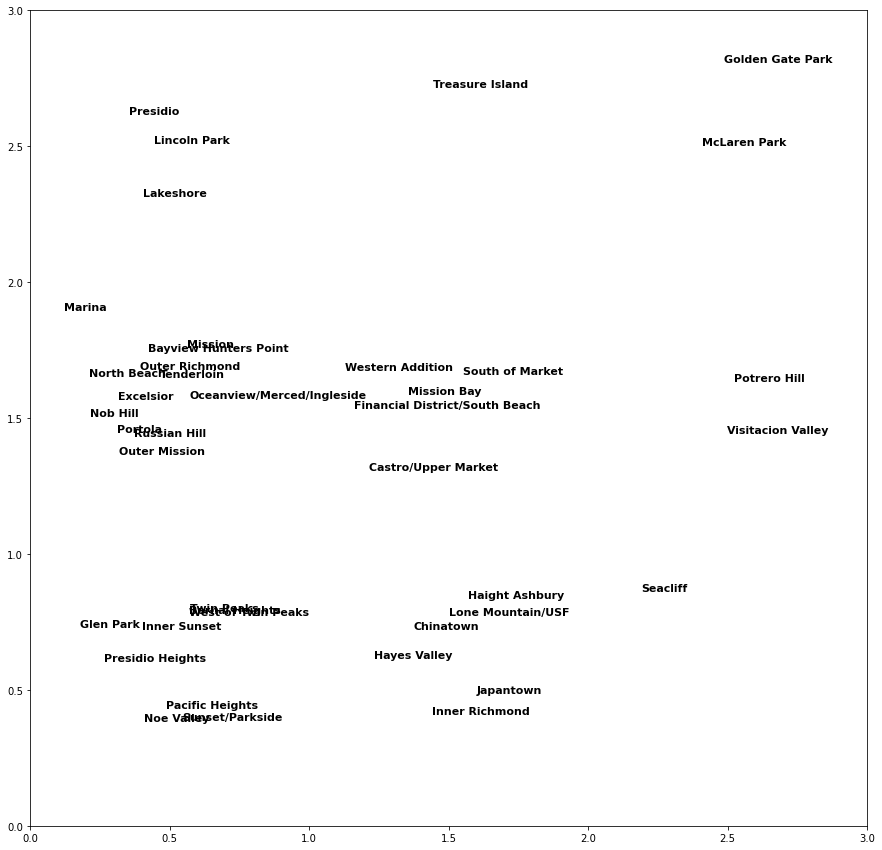

In [30]:
from minisom import MiniSom
SEED = 123

X = nhood_df.values
y = nhood_df.index

# Initialization and training
som_shape = (3,3)
som = MiniSom(som_shape[0], som_shape[1], X.shape[1], sigma = 0.5, learning_rate = 0.5, random_seed = SEED)
som.pca_weights_init(X)
som.train_random(X, 10000, verbose=False)

plt.figure(figsize=(15, 15))
for x, t in zip(X, y):
    #t = float(t)
    w = som.winner(x)
    xval = w[0]+.6+0.5*np.random.rand(1)-0.5
    yval = w[1]+.8+0.6*np.random.rand(1)-0.5
    plt.text(xval, yval,  t, fontdict={'weight': 'bold',  'size': 11})
    
plt.axis([0, som.get_weights().shape[0], 0,  som.get_weights().shape[1]])
plt.show()

#### Agglomerative Hierarchical Clustering and PCA

With the SOM above we have explored and learned that an instinctive grouping of neighbourhoods does exist, so we proceed to investigate how many clusters are meaningful for our analysis. We cluster by hierarchical clustering, since a dendogram provides us with a quick overview of where to cut, when balancing between the number of clusters, the within-clusters distance and metric plus the between-cluster distance and linkage method. In addition, we use Principal Component Analysis to project onto the first and second principal component to visually get an idea of which neighbourhoods are grouped.
After experimenting with the different parameters, the final choice fell on 10 clusters using the euclidean distance and Ward's linkage method.

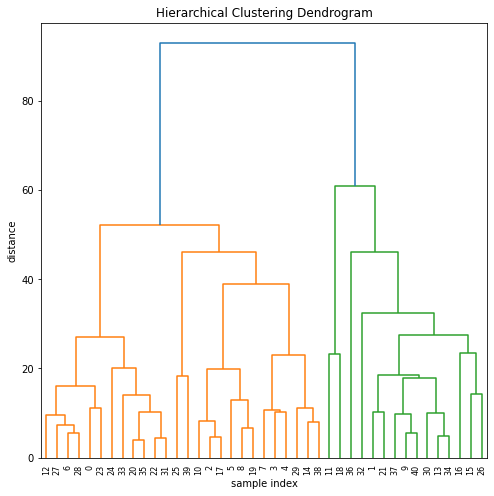

In [31]:
X = nhood_df.values
y = nhood_df.index

from scipy.cluster.hierarchy import dendrogram, linkage, fcluster, cophenet
d_sample = 'euclidean' #See possible values: https://docs.scipy.org/doc/scipy/reference/generated/scipy.spatial.distance.pdist.html#scipy.spatial.distance.pdist
d_group = 'ward'
N_leafs = 41

# method for cluster distance and distance metric
metric = 'euclidean'
method = 'ward'
N_leafs = 41
Z = linkage(X, method=method, metric=metric) 

# dendogram
plt.figure(figsize = (8,8))
plt.title('Hierarchical Clustering Dendrogram')
plt.xlabel('sample index')
plt.ylabel('distance')
den = dendrogram(
    Z,
    leaf_rotation=90.,
    leaf_font_size=8.,
    truncate_mode='lastp',
    p = N_leafs,
    show_contracted = True
)
plt.show()

##### Prinicipal Component Analaysis

In [32]:
### Number of clusters
k = 10
# designating clusters
cluster_designation = fcluster(Z, k, criterion='maxclust')

# Cluster dataframe
clust_df = pd.DataFrame(y, columns = ['nhood'])
cluster = [f'Cluster {cluster_designation[i]}' for i in range(len(y))]
cluster_num = [cluster_designation[i] for i in range(len(y))]
clust_df.insert(1, 'Cluster',cluster)
clust_df.insert(2, 'Cluster_num',cluster_num)
# Sort by cluster
clust_df = clust_df.sort_values(by=['Cluster_num'])


from sklearn.decomposition import PCA
# PCA analysis
pca = PCA(n_components=2)
components = pca.fit_transform(X)

# PCA dataframe
pca_df = pd.DataFrame(components, columns = ['PC1','PC2'])
pca_df.insert(0, 'nhood',y)
cluster = [f'Cluster{cluster_designation[i]}' for i in range(len(y))]
cluster_num = [cluster_designation[i] for i in range(len(y))]
pca_df.insert(3, 'Cluster',cluster)
pca_df = pca_df.sort_values('Cluster')

# Project onto first and second principal component
fig = px.scatter(pca_df,x='PC1',y='PC2', hover_name='nhood',color = 'Cluster')
fig.update_layout(
    width =800,
    height =800,
    title_text='PCA projection')

fig.update_traces(marker=dict(size=12,
                              line=dict(width=2,
                                        color='DarkSlateGrey')),
                  selector=dict(mode='markers'))

fig.show()

#### Results
The data frame constructed below is a table with the information on how each request category is distributed across clusters. For example, you can look at encampments and see that 37 % of all encampments are reported in Cluster 7.. This is the resulting information we achieved from the clustering analysis which we would like to communicate and visualize in the next section.

In [33]:
cols = nhood_df.columns
def cluster_percentage(category):
    # input: category
    # output: percentage of that category in each k clusters
    cluster_pct = []
    for i in range(1,k+1):
        cluster = nhood_df.T[clust_df[clust_df.Cluster_num == i].nhood].T
        cluster_cat = np.sum(cluster[category])
        total = np.sum(nhood_df[category])
        cluster_pct.append(cluster_cat/total*100)
    return cluster_pct

pct_df = pd.DataFrame()
for index in range(0,len(cols)):
    cluster_pct = cluster_percentage(cols[index])
    pct_df.insert(index, f'{cols[index]}',cluster_pct)

pct_df.index = clust_df.Cluster.unique()
pct_df.T.head()

,Cluster 1,Cluster 2,Cluster 3,Cluster 4,Cluster 5,Cluster 6,Cluster 7,Cluster 8,Cluster 9,Cluster 10
Street and Sidewalk Cleaning,18.524956,21.669161,4.728746,16.547297,13.502946,3.231768,15.165054,4.707048,1.302406,0.620619
Graffiti,11.466003,12.626279,2.465023,28.303315,14.260101,5.069439,17.308914,6.504760,1.058941,0.937225
Encampments,8.295530,20.672009,3.064975,13.996146,37.157618,2.368503,7.715420,4.739141,1.256698,0.733960
Abandoned Vehicle,15.569514,5.778502,4.242145,4.434335,4.233325,3.179589,39.578241,10.543875,11.679662,0.760813
MUNI Feedback,10.151102,9.925982,3.240910,7.941761,16.857097,2.341173,16.578435,16.630766,0.599278,15.733494


#### Visualizing and Exploring Clusters <a class="anchor" id="s_3_3_2"></a>

##### Geographical Overview:
The code below produces a map of San Francisco where each of the 41 neighbourhoods are outlined and coloured according to which of the 10 clusters it belongs to. Due to the size of the plot, it is not plotted, but if you [click here](https://sanfranciscodatatrip.github.io/cluster_SF_neighbourhoods.html), it will open in a new tab. In the plot you can click on a cluster in the menu on the left, to make it appear or disappear on the map.

You can see that in some clusters the neighbourhoods are geographically close, like Cluster 7 because different areas of a city have different challenges. For example, downtown areas are different from residential areas, since they are used in different ways by different people. If you consider Cluster 6 you will see that it is more spread out, but will have similarities based on what kind of area they are.

In [34]:
# import chart_studio
# import chart_studio.plotly as py
# import plotly.offline as pyo
# import plotly.graph_objects as go
# import plotly.express as px
# # Set notebook mode to work in offline
# pyo.init_notebook_mode()

# chart_studio.tools.set_credentials_file(username='mmestre',
# api_key='YbVYpQRqmw3RvNPohYBn')

# import plotly.express as px

# geodata = clust_df.copy()

# fig = px.choropleth_mapbox(geodata, geojson=gj, locations='nhood', 
#                            featureidkey="properties.nhood",
#                            color='Cluster',
#                            mapbox_style="carto-positron",
#                            zoom=10.2, center = {"lat": 37.765, "lon": -122.446},
#                            opacity=0.5,
#                            labels={'Cluster','Neighborhoods'},
#                            title="Clusters of SF neighborhoods based on the distribution of 311 request"
#                           )
# #fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
# fig.show()
# #py.plot(fig, filename='cluster_map')
# #fig.savefig('words_white.png')
# #fig.write_html("cluster.html")

##### Wordclouds

Below you will see a word cloud for each cluster. The words displayed are the type of 311 request each cluster experiences, and the size of the word tells you how frequent a request is within that cluster. 


All categories are represented in almost all cluster, but you can quickly see what the prominent issues people have, for example, the most concerning issues in Cluster 4 is Graffiti and Illegal Posting and people visiting Cluster 10, frequently give MUNI feedback . You can also see that some clusters have a broader palette of complaints, like Cluster 1.

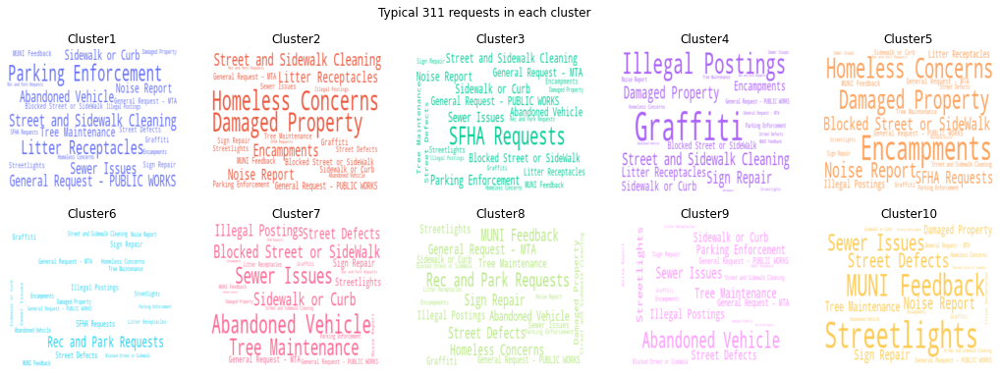

In [35]:
from wordcloud import WordCloud
import matplotlib.image as mpimg
import matplotlib as mpl
from PIL import Image

# Data for the wordclouds
worddata = pct_df.T
C = worddata.columns

# use same colors for each cluster as in the other plots
color = ['#636EFA',
'#EF553B',
'#00CC96',
'#AB63FA',
'#FFA15A',
'#19D3F3',
'#FF6692',
'#B6E880',
'#FF97FF',
'#FECB52']

fig, axs = plt.subplots(nrows = 2 , ncols = 5,figsize = (18,6))

for i in range(k):
    text=worddata[C[i]].sort_values(ascending=False)
    wordcloud = WordCloud(background_color='white',contour_width=1,
                          contour_color='black',
                          color_func=lambda *args, **kwargs: color[i],
                           width=400, height = 200).generate_from_frequencies(text)
    #plot
    axs[i//5,i%5].imshow(wordcloud, interpolation='bilinear',aspect="auto")
    axs[i//5,i%5].set_title(f'Cluster{i+1}')
    axs[i//5,i%5].axis('off')
#plt.tight_layout()
fig.suptitle('Typical 311 requests in each cluster')
plt.show()
#fig.savefig('words_white.png')

##### Barplot - The distribution of 311 requests in each cluster:
Below you will see a bar plot with a horizontal bar for each focus request, and each color represents a cluster so it can be seen how much each cluster contributes to an issue. For example, can you hover over encampments and see that 37 % of all encampments are reported in Cluster 7.
You can also go unpick all clusters except one, and you can see the distribution of complaints in each cluster. 

In [36]:
bardata = pct_df.T
bardata = bardata.round(2)
C = bardata.columns
bardata.insert(0,'type',bardata.index)

fig = px.bar(bardata, x=C, y='type',
            title="Distribution of 311 requests across clusters",
            labels={"value": "Percentage", "variable": "Cluster",'type':'311 request type'})
fig.show()
#py.plot(fig, filename='cluster_barplot')

#### The different types of neighbourhoods in San Francisco:
We will now with aid from the map, word clouds and barplot dive into each cluster and try to explain what 311 requests that characterizes them. 

**The Parks and Recreations of San Francisco**
- We start by diving into Cluster 6, so go and unpick all other clusters in the barplot. If you hover over the map, you see that this cluster consists of three park neighbourhoods so naturally the majority of concerns and requests about Parks and Recreations. In fact, if you hover over the Rec and Park Requests in the barplot it is seen that about 57 % of all requests of this type are in this cluster. Another concern in this cluster is the homeless who might favor seeking shelter in parks.
- Cluster 7 includes the neighbourhood Presidio, a big park area where the Golden Gate Bridge connects, the park Lincoln Park, plus Lakeshore, a nice area with a lake, park and the zoo! Here you will, as in Cluster 6, have many people with requests about parks and recreation, but instead of homeless concerns people in Cluster 7 complain about street defects and sign repair. People in this cluster also provide a lot of feedback for the public transport system MUNI, which might stem from tourists or visitors travelling to these areas by public transportation.

**The odd ones out**
- The neighbourhood Seacliff is the singleton Cluster 9. It separates itself from other neighbourhoods because it has extraordinary high frequency of complaints regarding Abandoned Vehicles. 
- Cluster 10 consists solely of Treasure Island, a small artificial Island that according to 311 data has biggest problems with Streetlights and Sewers Issues. Almost 30 % of all streetlight complaints are from here. Again we have a cluster that provides loads of Muni Feedback.

**The crowded and busy city center**
- Now we go into the areas around the city center which are Cluster 3 and Cluster 5. The complaints and requests in these two clusters are almost the same but with slight differences. Both clusters struggle with homeless people and together these two clusters have almost 50% of all Homeless Concerns and over 60% of all Encampment complaints. The complaint types here are reflected by the fact that these neighbourhoods are very active and crowded with commercial areas, bars and business areas. For example  you will see many complaints about noise, litter, damaged property, blocked traffic, cleanliness. You will not experience many abandoned vehicles here since we might speculate that people would do that in more deserted areas.
- Another cluster in the center of San Francisco is Cluster 4, which you can see on the map consists of three small neighbourhoods including Chinatown. In contrast to Cluster 3 and Cluster 5 this cluster doesn't struggle as much with encampments and homeless, but has about the same amount of complaints about Graffiti and Illegal Posting as Cluster 5 even though Cluster 4 accounts for way less 311 requests in total.

**The outskirt of the center**
- Cluster 8 represents a big number of neighbourhoods in the outskirts of the center and also accounts for a big chunk of all requests in all categories. In contrast to the more crammed and busy clusters, these areas will be more residential but also contain more deserted areas where people dump their cars. You can see in the barplot that 41 % of the total amount of Abandoned Vehicles are found in this cluster. Other notable complaints are about the Sewer Issues and Tree Maintenance.
- In addition we see Cluster 1 on the map as three spread out chunks of neighbourhoods in the outer areas of San Francisco. If you come to these areas of town you will experience issues within all categories but the need for Parking Enforcement might stand out!
- Lastly you can see that Cluster 2 is a collection of neighbourhoods by the Bay. This includes the neighbourhood Portola wherein the office of San Francisco Housing Authority lies, hence the overwhelming amount of SFHA requests. Otherwise you can experience a broad palette of issues, just as in Cluster 1.

## 4. Genre <a class="anchor" id="c4"></a>

We knew from the beginning that we wanted our visualizations to have an interactive component, engaging the user in exploring the story we are telling about the patterns and developments in the SF311 dataset. For that reason, each section includes several interactive plots. To explore the temporal development and the temporal-spatial development we knew from the start that we wanted the visualizations to include timeline sliders. This way the user is engaged and get the feeling of the discovering the development over time in categories of interest.  

 

Overall, we leverage several genres, including “annotated charts” and “partitioned posters”. Each visualization leans more towards one of the genres depending on whether we want to emphasize a reader-driven or author-driven approach. For instance, in the first part [3.1.1](#s_3_1_1) where we explore the overall temporal development of the categories and complaint sources, we leverage basic “magazine style” visualizations, consisting of only a single frame with no interactive properties. We leverage “magazine style” genre in this section to ensure that the user follows a predefined path, and thereby receives the exact story we want to tell. However, in this part we also have highly interactive visualizations, allowing the reader to explore the data on her own. This is exemplified by what we consider the main visualization of this part, visualizing the development in the total number of complaints for different categories. Here the reader can filter by year, month and zoom in on specific time intervals of interest. Additionally, the reader can select categories of interest with a drop-down menu and decide whether you only want to see the last 3 years, the last 5 years or just all years.  

 

To keep the visual platform coherent, we used the visual narrative tactic of Consistent Visual Platform. By having a coherent visual platform, the user is not overwhelmed by too many changing visual inputs and attention is thereby focused on the most important aspect; the changing content when engaging in the interactive visualizations. This is exemplified by the main plot in the part [3.1.1](#s_3_1_1), where visual platform remains consistent when the content is explored by the user. 

## 5. Visualization <a class="anchor" id="c5"></a>
**Temporal**

To investigate the temporal development in the number of complaints within each category we used interactive bar plots and violin plots. As described in section 4, we emphasized interactive plots to engage the reader. Bar plots were chosen to visualize changes in number of complaints because they excel at efficiently communicating differences in amounts. You can stack a large amount of bars next to each other while maintaining interpretability. Since we are dealing with a very large data set with several categories, years and months, this was a highly desired property for our purpose. In addition, violin plots were implemented to visualize the distribution of complaints during the hours of the day. By plotting several categories next to each other, the violin plot allows for easy interpretation of how the distributions differ.

**Temporal-spatial** 

To visualize the development in the geographical distribution of complaints for different categories we implemented geographical scatterplots, because they excel at visualising distributions of observations. In addition, scatterplots have several parameters such as opacity and markersize which can be adjusted to improve interpretability. The major limitation of scatter plots is that only the distributions of a few categories can be visualized in the same plot. We found that 2 or 3 categories were the maximum while maintaining interpretability. 

**Neighbourhood clustering**

Finally, we implemented choropleth plots to investigate differences in complaint type concentrations in each neighbourhood. Hence, choropleth plots were implemented to visualize the geographical component. To visualize the resulting cluster of our unsupervised clustering analysis, we used word clouds, because they give a quick overview of the clusters. To combine the choropleth map with our findings from our unsupervised clustering, we colored each neighbourhood based on which cluster it belonged to. To visualize the raw distributions of complaint types and how much each cluster describes each complaint type we implemented a bar plot. This bar plot conveys a lot of information and is for diving deeper into the raw data. For instance, if one cluster is selected, the distribution of complaints within that cluster is visualized.


## 6. Discussion <a class="anchor" id="c6"></a>

During the project we have worked in depth with the SF311 dataset. The dataset is very dense and contains vast amounts of information. For that reason, we often found it difficult to set a clear direction for our analysis as well as defining a clearly structured and interesting story. Considering the complexity of the dataset, we think that we really dived deep into the detail

Due to time constraints we did not have the time needed to dive deep into each topic covered in the three different sections. When investigating the temporal development of complaint types, diving into the impact of Covid19 is an entire project in itself. The same is true for the last part investigating the clustering of neighbourhoods. In addition to solely the concentration of complaint types, several other variables could have been included to add more dimensions to the clustering model. One interesting variable to include would be the budget assigned to each neighbourhood and then investigating how that impacts the clustering of neighbourhoods over time.


Throughout this project, interactive and visually appealing plots have been centerpiece and we think we succeeded with this to a large extent. Additionally, we set out to investigate whether neighbourhoods could be clustered into meaningful clusters, and based on our results, we are confident to say that we gained and communicated some valuable insights about this aspect. Finally, a lot of effort was put into the website, striving to present a clear, coherent, engaging and interesting story to the reader. However, given additional resources, all of these areas could of course have been improved even further.


## 7. Contributions <a class="anchor" id="c7"></a>

During this project 

* Marc (s210152) has focused on the section *Temporal Patterns* and development of the webpage in its entirety.  

* Mads (s195552) has focused on the section *Spatiotemporal Pattern*, exploratory clustering (SOM) and is the main author.

* Pernille (s193281) has focused on the section *Cluster Analysis* plus merging doing the layout of the final notebook.

However, it is worth noting the great collaboration throughout the course, both in the assignments and in the final project, so that each of us has been aware of and contributed to the project in an equal proportion.

## 8. References <a class="anchor" id="c8"></a>

* The main dataset used is open data from [DataSF](https://data.sfgov.org/City-Infrastructure/311-Cases/vw6y-z8j6)